# Make postISRCCD from raw for Spectractor StandAlone


- work with Weakly_2023_35


- author : Sylvie Dagoret-Campagne
- affiliation : IJCLab
- creation date : 2023/09/13
- last update : 2023/09/18



write output file according hierarchy

         filter/DATE


In [1]:
! eups list -s | grep LOCAL

analysis_tools        LOCAL:/home/d/dagoret/repos/repos_w_2023_35/analysis_tools 	setup
atmospec              LOCAL:/home/d/dagoret/repos/repos_w_2023_35/atmospec 	setup
eups                  LOCAL:/opt/lsst/software/stack/conda/miniconda3-py38_4.9.2/envs/lsst-scipipe-7.0.1/eups 	setup
spectractor           LOCAL:/home/d/dagoret/repos/repos_w_2023_35/Spectractor 	setup


In [2]:
! echo $IMAGE_DESCRIPTION
! eups list -s lsst_distrib

Weekly 2023_35
   g4213664e8e+c55b99ec95 	current w_2023_35 setup


In [3]:
import os
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cm as cmx
import matplotlib.dates as mdates

import numpy as np
import pandas as pd
%matplotlib inline
from matplotlib.colors import LogNorm

from mpl_toolkits.axes_grid1 import make_axes_locatable

import matplotlib.ticker                         # here's where the formatter is
from matplotlib.ticker import (MultipleLocator, FormatStrFormatter,
                               AutoMinorLocator)

from astropy.visualization import (MinMaxInterval, SqrtStretch,ZScaleInterval,PercentileInterval,
                                   ImageNormalize,imshow_norm)
from astropy.visualization.stretch import SinhStretch, LinearStretch,AsinhStretch,LogStretch


from astropy.io import fits




In [4]:
# Assembly task
# https://github.com/lsst/ip_isr/blob/main/python/lsst/ip/isr/isrTask.py

from lsst.ip.isr.assembleCcdTask import (AssembleCcdConfig, AssembleCcdTask)
from lsst.ip.isr.isrTask import (IsrTask, IsrTaskConfig)

#https://github.com/lsst/ip_isr/blob/main/python/lsst/ip/isr/overscan.py
from lsst.ip.isr import  OverscanCorrectionTaskConfig, OverscanCorrectionTask

In [5]:
# LSST Display
import lsst.afw.display as afwDisplay
afwDisplay.setDefaultBackend('matplotlib')

In [6]:
import lsst.daf.butler as dafButler

In [7]:
import warnings
warnings.filterwarnings("ignore")

# Configuration

In [8]:
FLAG_PLOT=True

In [9]:
#DATE = 20230117
#FILTER="empty-holo4_003"
#FILTER="BG40_65mm_1-holo4_003"
#FILTER="OG550_65mm_1-holo4_003"

#DATE = 20230118
#FILTER = "BG40_65mm_1-holo4_003"
#FILTER = "OG550_65mm_1-holo4_003"
#FILTER = "empty-holo4_003"

#DATE = 20230119
#FILTER="empty-holo4_003"
#FILTER="BG40_65mm_1-holo4_003"
#FILTER="OG550_65mm_1-holo4_003"

#DATE = 20230131
#FILTER = "empty-holo4_003"
#FILTER="BG40_65mm_1-holo4_003"
#FILTER="OG550_65mm_1-holo4_003"


#DATE = 20230201
#FILTER = "empty-holo4_003"
#FILTER="BG40_65mm_1-holo4_003"
#FILTER="OG550_65mm_1-holo4_003"


#DATE = 20230202
#FILTER = "empty-holo4_003"
#FILTER="BG40_65mm_1-holo4_003"
#FILTER="OG550_65mm_1-holo4_003"

#DATE = 20230215
#FILTER="empty-holo4_003"


#DATE = 20230315
#FILTER="empty-holo4_003"

#DATE = 20230316
#FILTER="empty-holo4_003"

#DATE = 20230704
#FILTER = "empty-holo4_003"

#DATE = 20230705
#FILTER = "empty-holo4_003"

#DATE = 20230706
#FILTER = "empty-holo4_003"


#DATE = 20230718
#FILTER = "empty-holo4_003"

#DATE = 20230720
#FILTER = "empty-holo4_003"

#DATE = 20230801
#FILTER = "empty-holo4_003"

#DATE = 20230802
#FILTER = "empty-holo4_003"

#DATE = 20230815
#FILTER = "empty-holo4_003"

#DATE = 20230817
#FILTER = "empty-holo4_003"


DATE = 20230912
#FILTER="cyl_lens-holo4_001"
#FILTER="cyl_lens-holo4_003"
#FILTER="collimator-holo4_003"
#FILTER="empty-holo4_001"
FILTER="empty-holo4_003"

#DATE = 20230913
#FILTER="collimator-holo4_003"
#FILTER="cyl_lens-holo4_003"
#FILTER="empty-holo4_003"
#FILTER="empty-holo4_001"

#DATE = 20230914
#FILTER="collimator-holo4_003"
#FILTER="cyl_lens-holo4_003"
#FILTER="empty-holo4_003"
#FILTER="empty-holo4_001"

#filename_visits = f"visitdispersers_{DATE}_filt_{FILTER}.list"
filename_visits = f"all_visitdispersers/{DATE}/visitdispersers_{DATE}_filt_{FILTER}.list"

In [10]:
# output path of type top/date/filter
#----------------------------------------

top_path_out="my_postisrccd_img"
path_out=f"{top_path_out}/{FILTER}"

In [11]:
if not os.path.exists(path_out):
    os.makedirs(path_out)

In [12]:
path_out=f"{path_out}/{DATE}"

if not os.path.exists(path_out):
    os.makedirs(path_out)

# read list of exposures

- generated by ListOfExposures-hologram.ipynb

In [13]:
df = pd.read_csv(filename_visits, header=None,skiprows = 1, sep=' ',names=["date","seq"])
df

,date,seq
0,20230912,152
1,20230912,153
2,20230912,212
3,20230912,213
4,20230912,214
5,20230912,215
6,20230912,216
7,20230912,217
8,20230912,228
9,20230912,229


In [14]:
for index,row in df.iterrows():
    exposure_selected =row["date"]*100000+row["seq"]
    print(exposure_selected)

2023091200152
2023091200153
2023091200212
2023091200213
2023091200214
2023091200215
2023091200216
2023091200217
2023091200228
2023091200229
2023091200230
2023091200247
2023091200248
2023091200262
2023091200263
2023091200277
2023091200278
2023091200292
2023091200293
2023091200307
2023091200308
2023091200322
2023091200323
2023091200337
2023091200338
2023091200352
2023091200353
2023091200367
2023091200368
2023091200382
2023091200383
2023091200397
2023091200398
2023091200421
2023091200422


## Select flags options

In [15]:
FLAG_ROTATE_IMG = True
FLAG_TRANSFORM = True

## Transformations
astropy scale transformations

In [16]:
transform = AsinhStretch() + PercentileInterval(99.)
#transform = PercentileInterval(98.)

## Butler

In [17]:
#repo = '/sdf/group/rubin/repo/main'
repo="/sdf/group/rubin/repo/oga/"
butler = dafButler.Butler(repo)
registry = butler.registry

In [18]:
collection='LATISS/raw/all'

In [19]:
# configuration
isr_config =  IsrTaskConfig()

In [20]:
isr_config.doDark = False
isr_config.doFlat =  False
isr_config.doFringe = False
isr_config.doDefect = True
isr_config.doLinearize = False
isr_config.doCrosstalk =  False
isr_config.doSaturationInterpolation = False
isr_config.overscan.fitType: 'MEDIAN_PER_ROW'
isr_config.doBias: True


In [21]:
isr_task = IsrTask(config=isr_config)

In [22]:
###########################################
# REPO=/repo/embargo
# butler query-collections $REPO LATISS/calib
#############################################

In [23]:
calibType = 'bias'
physical_filter = 'empty~empty'
cameraName = 'LATISS'
# Collection name containing the verification outputs.
calibCollections = ['LATISS/calib','LATISS/raw/all',]                   

In [24]:
butler = dafButler.Butler(repo, collections=calibCollections)
camera = butler.get('camera', instrument=cameraName)
#bias = butler.get('bias',instrument=cameraName,detector=0)
#defects = butler.get('defects',instrument=cameraName,detector=0)


Exposure 2023091200152, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200152, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200153, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200153, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200212, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200212, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200213, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200213, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200214, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200214, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200215, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200215, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200216, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200216, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200217, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200217, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200228, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200228, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200229, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200229, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200230, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200230, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200247, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200247, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200248, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200248, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200262, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200262, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200263, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200263, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200277, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200277, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200278, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200278, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200292, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200292, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200293, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200293, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200307, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200307, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200308, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200308, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200322, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200322, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200323, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200323, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200337, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200337, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200338, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200338, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200352, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200352, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200353, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200353, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200367, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200367, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200368, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200368, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200382, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200382, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200383, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200383, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200397, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200397, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200398, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200398, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200421, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200421, DATE for Master Defect with short calib list 2022-06-08 17:35:34


Exposure 2023091200422, DATE for Master Bias with short calib list 2023-04-28 14:13:20 PDT
Exposure 2023091200422, DATE for Master Defect with short calib list 2022-06-08 17:35:34


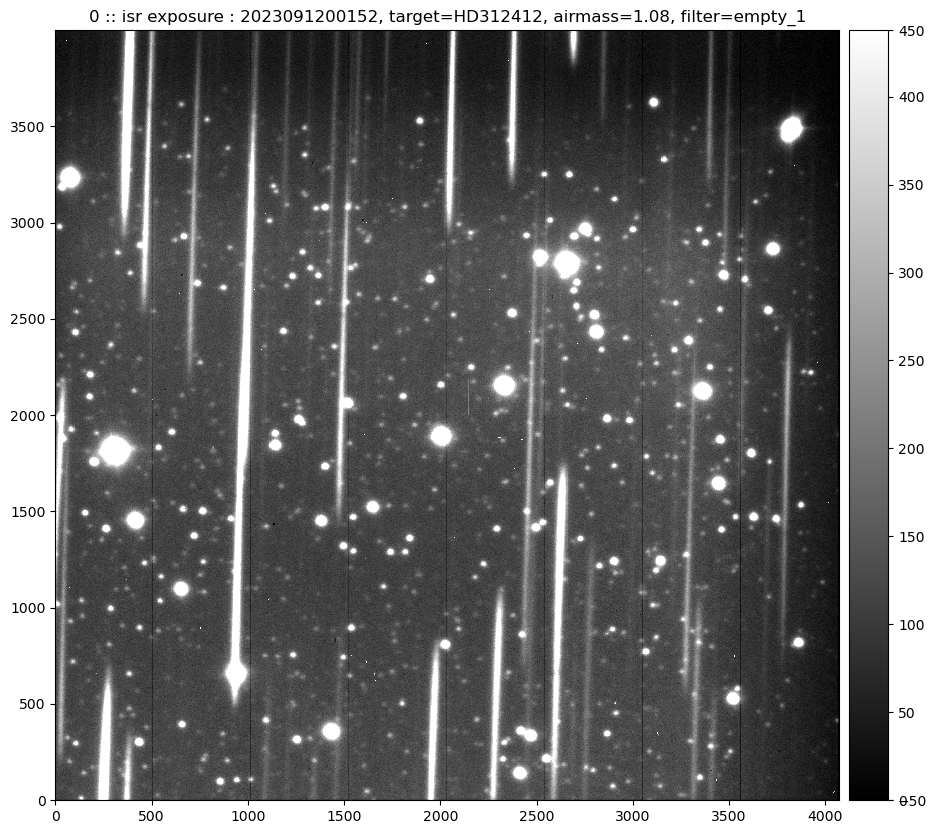

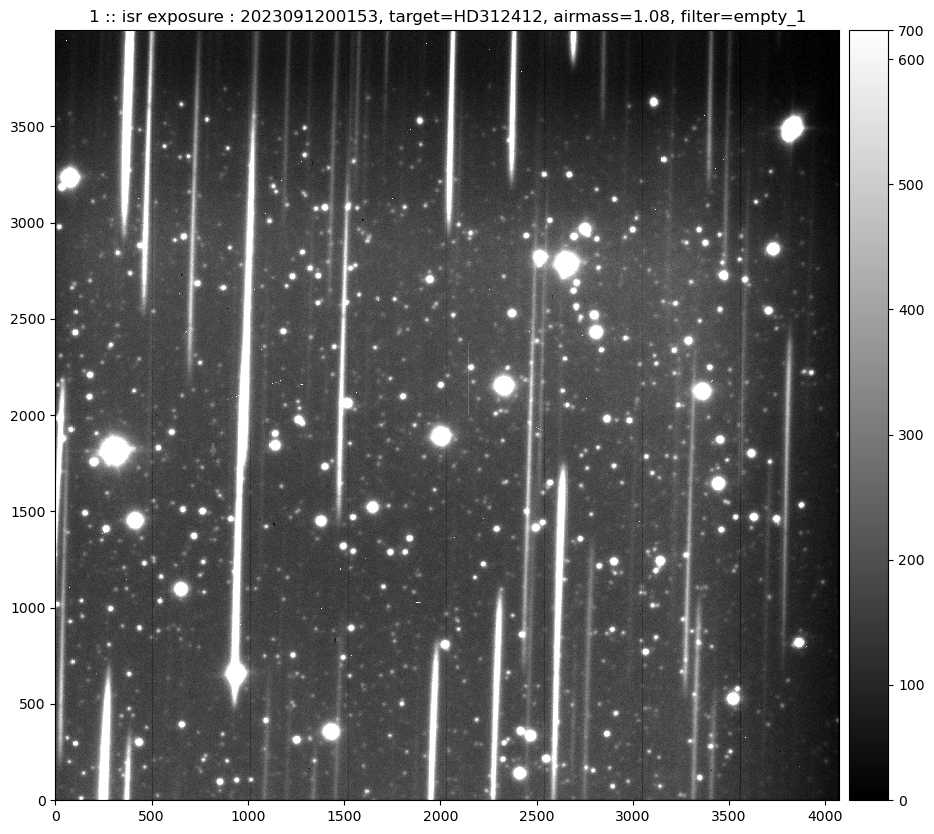

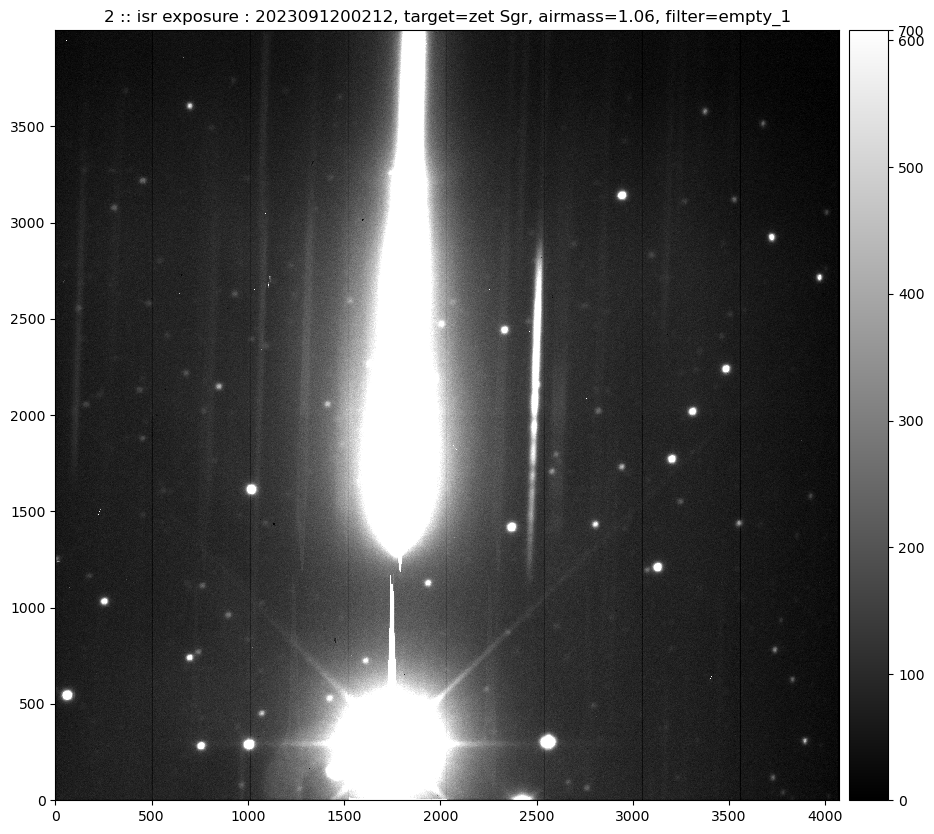

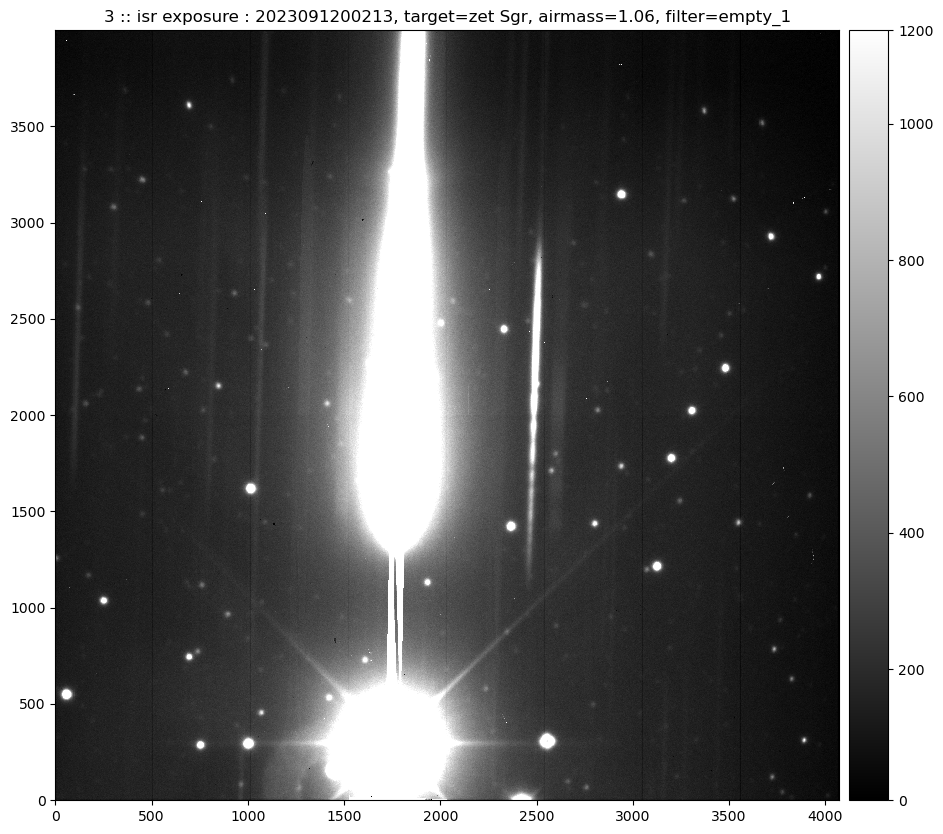

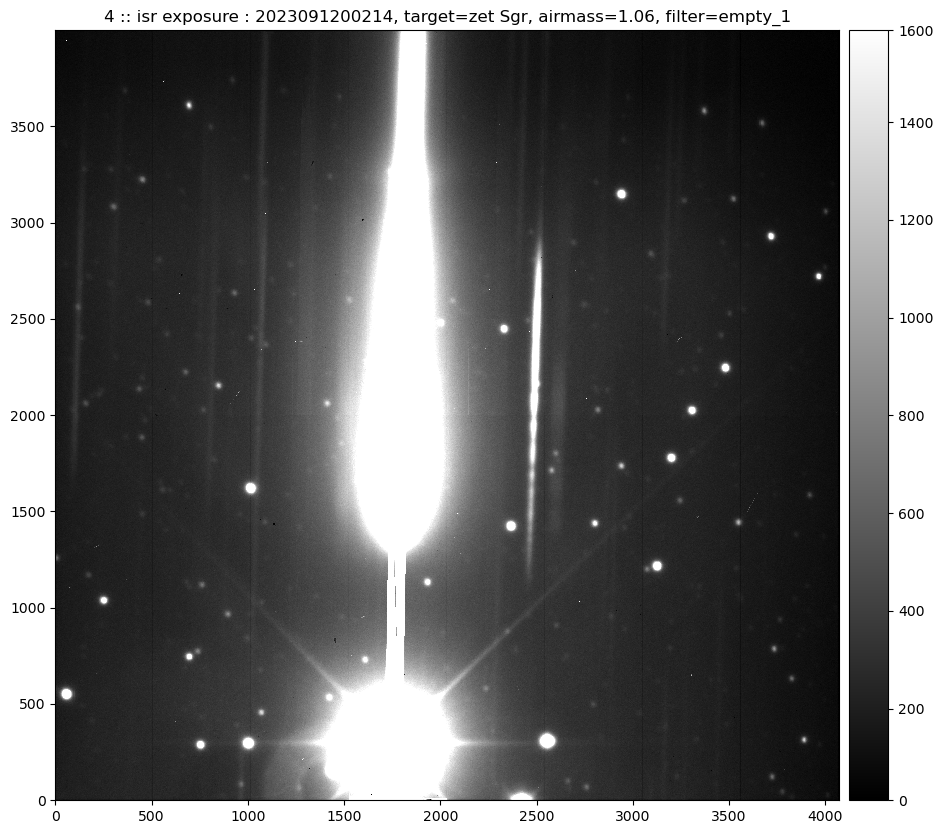

...

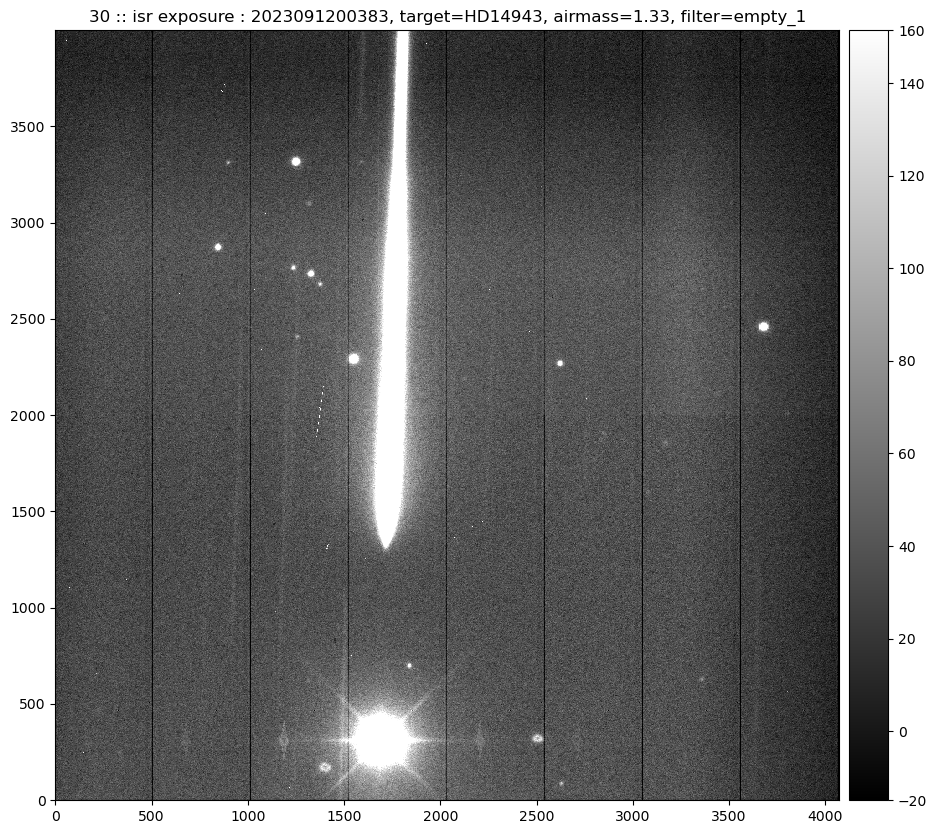

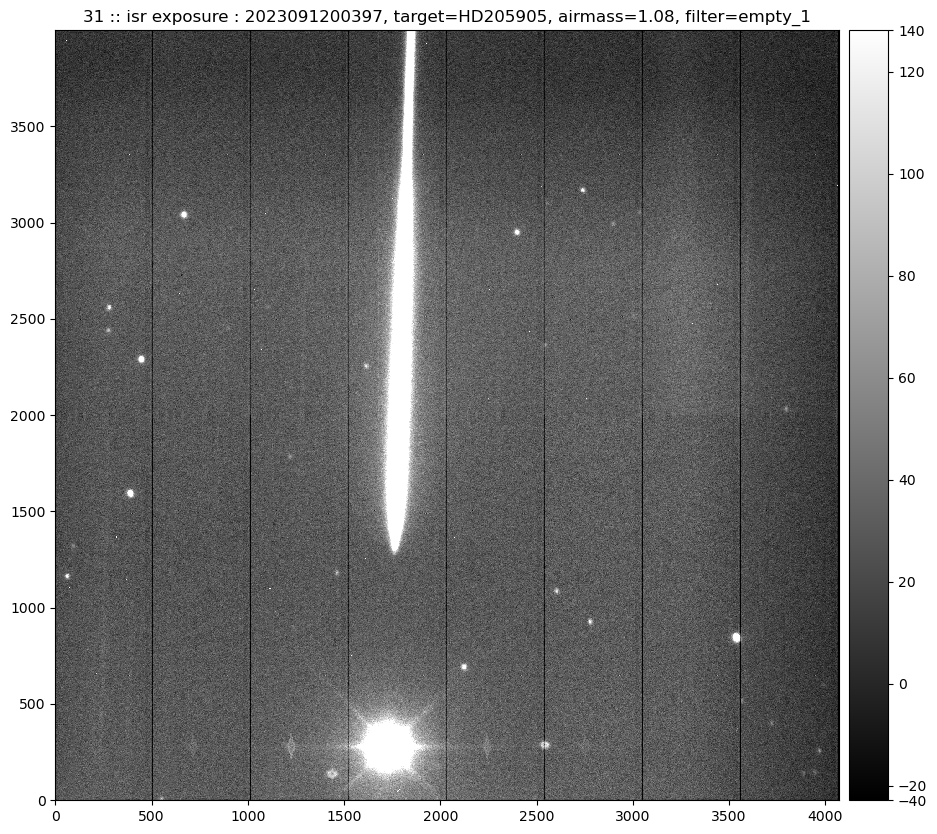

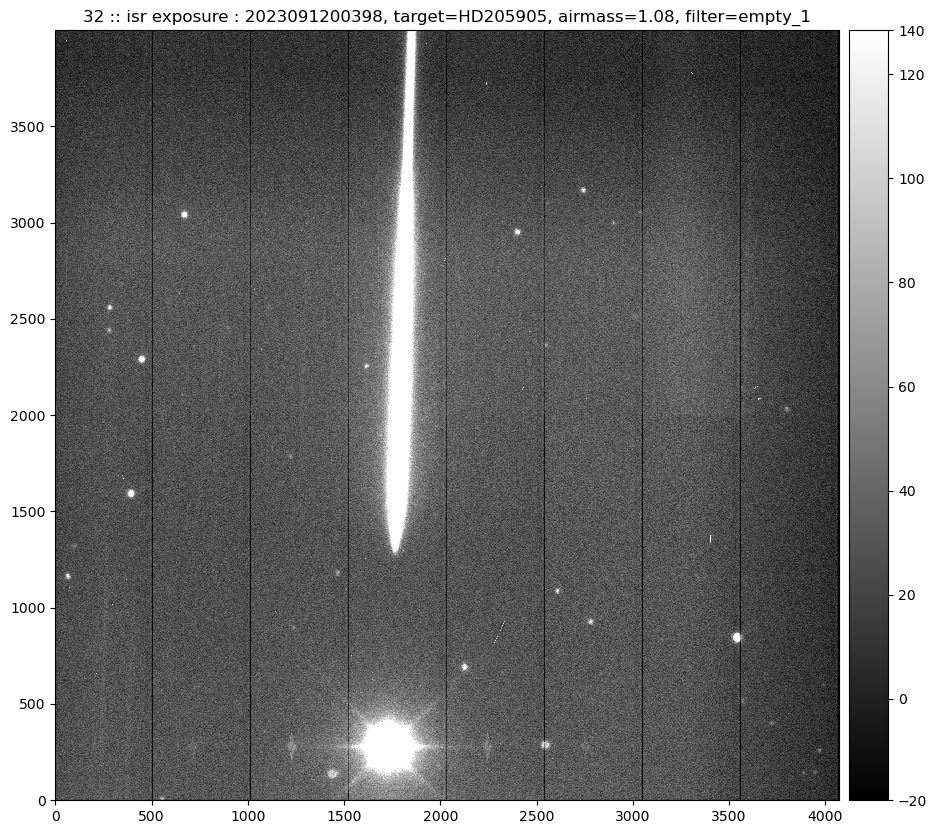

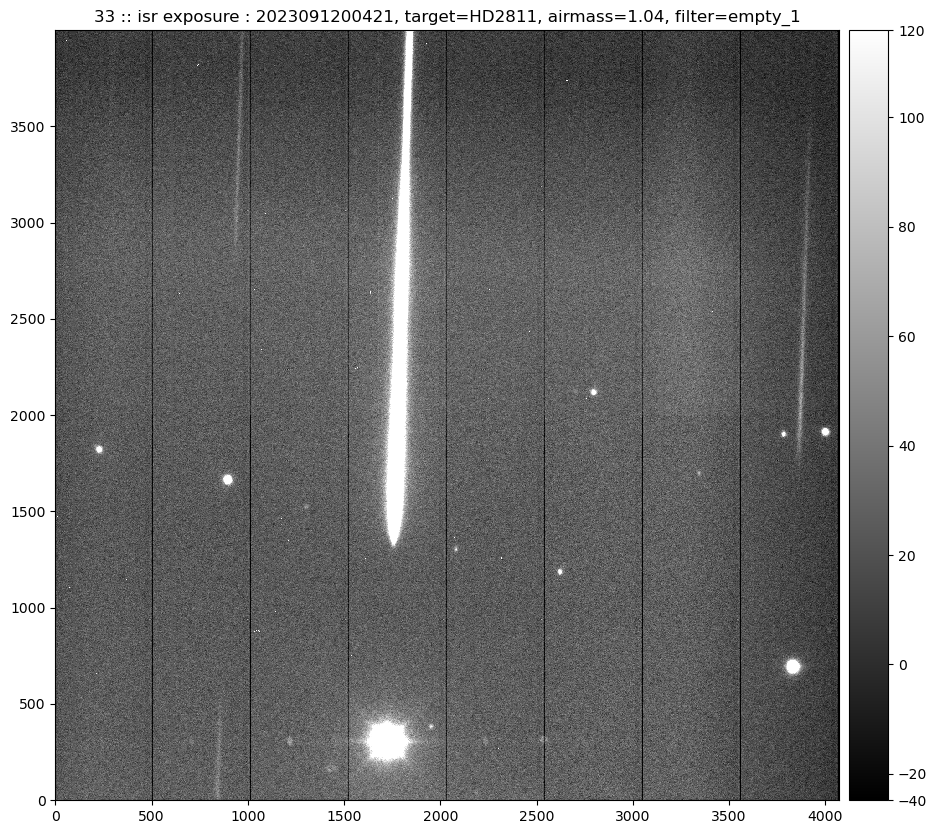

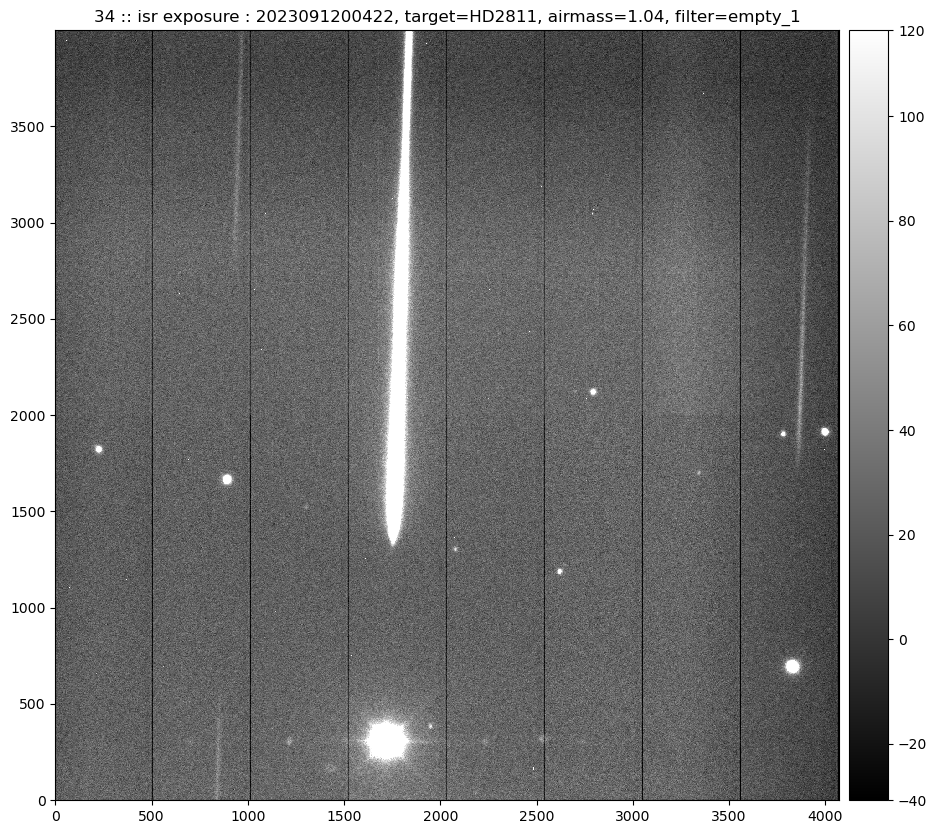

In [25]:
%matplotlib inline
if FLAG_PLOT:
    for index,row in df.iterrows():
        exposure_selected =row["date"]*100000+row["seq"]



        raw_img= butler.get('raw', dataId={'exposure': exposure_selected, 'instrument': 'LATISS', 'detector': 0}, collections = collection)
        bias = butler.get("bias",instrument=cameraName, exposure= exposure_selected , detector=0, collections=calibCollections)
        defects = butler.get('defects',instrument=cameraName, exposure= exposure_selected ,detector=0,collections=calibCollections)
    
    
            # get metadata
        bias_md = dict(bias.getMetadata())
        MB_date= bias_md['CALIB_CREATION_DATE']
        MB_time = bias_md['CALIB_CREATION_TIME']
        print(f"Exposure {exposure_selected}, DATE for Master Bias with short calib list",MB_date, MB_time)
    
        defects_md = dict(defects.getMetadata()) 
        DF_date= defects_md['CALIB_CREATION_DATE']
        DF_time = defects_md['CALIB_CREATION_TIME']
        print(f"Exposure {exposure_selected}, DATE for Master Defect with short calib list",DF_date, DF_time)
    
        meta = raw_img.getMetadata()
        md = meta.toDict()
    
        the_object = md['OBJECT']
        
        if the_object == "MU-COL":
            md['OBJECT']="HD38666"
            the_object = md['OBJECT']
            
        if the_object == "ETA1-DOR":
            md['OBJECT']="HD42525"
            the_object = md['OBJECT']
            
            
        the_am= md['AMSTART']
        the_filter=md['FILTER']
    
        #fast ISR 
        isr_img = isr_task.run(raw_img,bias=bias,defects=defects)
    
        rotated_array = isr_img.exposure.image.array[::-1,::-1] #rotate the array 180 degrees
        #np.flip(np.flip(a, 1), 0)

    
        fig = plt.figure(figsize=(12,10))
        afw_display = afwDisplay.Display(frame=fig)
        afw_display.scale('linear', 'zscale',None)
        the_title = f"{index} :: isr exposure : {exposure_selected}, target={the_object}, airmass={the_am:.2f}, filter={the_filter}"
        afw_display.mtv(isr_img.exposure.image,title=the_title)

In [26]:
# Save in files

In [27]:
for index,row in df.iterrows():
    
    exposure_selected =row["date"]*100000+row["seq"]
    
    print(f"exposure selected = {exposure_selected}")


    raw_img= butler.get('raw', dataId={'exposure': exposure_selected, 'instrument': 'LATISS', 'detector': 0}, collections = collection)
    bias = butler.get("bias",instrument=cameraName, exposure= exposure_selected , detector=0, collections=calibCollections)
    defects = butler.get('defects',instrument=cameraName, exposure= exposure_selected ,detector=0,collections=calibCollections)
    
    
    isr_img = isr_task.run(raw_img,bias=bias,defects=defects)
    
    arr=isr_img.exposure.image.array
    # 180 degree rotation
    rotated_array = arr[::-1,::-1] #rotate the array 180 degrees
    
    
    meta = raw_img.getMetadata()
    md = meta.toDict()

    the_object = md['OBJECT']
    the_am= md['AMSTART']
    the_filter=md['FILTER']
    
    if the_object == "MU-COL":
        md['OBJECT']="HD38666"
        the_object = md['OBJECT']

    filename_out = f"exposure_{exposure_selected}_pseudo-postisrccd.fits"
    fullfilename_out=os.path.join(path_out,filename_out)
    
    print(f">>>>  output filename {filename_out} object {the_object}")
    
    hdr = fits.Header()
    
    for key,value in md.items():
        if key == 'OBJECT':
            print(key,value)
        hdr[str(key)]=value
        
    # need this    
    hdr["AMEND"] = hdr["AMSTART"]
    
    # be aware weather data may be missing
    if hdr["AIRTEMP"] == None:
        hdr["AIRTEMP"] = 10.0

    if hdr["PRESSURE"] == None:
        hdr["PRESSURE"] = 744.

    if hdr["HUMIDITY"] == None:
        hdr["HUMIDITY"] = 50.

    if hdr["WINDSPD"] == None:
        hdr["WINDSPD"] = 5.

    if hdr["WINDDIR"] == None:
        hdr["WINDDIR"] = 0.   

    if hdr["SEEING"] == None:
        hdr["SEEING"] = 1.15
    
        
   
    
    # Be carefull for Spectractor, 2 hdu units are necessary
    
    primary_hdu = fits.PrimaryHDU(header=hdr)
    image_hdu = fits.ImageHDU(rotated_array)
    
    hdu_list = fits.HDUList([primary_hdu, image_hdu])
    
    hdu_list.writeto(fullfilename_out,overwrite=True)
    
    
    
    #if index>=0:
    #    break
    


exposure selected = 2023091200152


>>>>  output filename exposure_2023091200152_pseudo-postisrccd.fits object HD312412
OBJECT HD312412
exposure selected = 2023091200153


>>>>  output filename exposure_2023091200153_pseudo-postisrccd.fits object HD312412
OBJECT HD312412
exposure selected = 2023091200212


>>>>  output filename exposure_2023091200212_pseudo-postisrccd.fits object zet Sgr
OBJECT zet Sgr
exposure selected = 2023091200213


>>>>  output filename exposure_2023091200213_pseudo-postisrccd.fits object zet Sgr
OBJECT zet Sgr
exposure selected = 2023091200214


>>>>  output filename exposure_2023091200214_pseudo-postisrccd.fits object zet Sgr
OBJECT zet Sgr
exposure selected = 2023091200215


>>>>  output filename exposure_2023091200215_pseudo-postisrccd.fits object HD167611
OBJECT HD167611
exposure selected = 2023091200216


>>>>  output filename exposure_2023091200216_pseudo-postisrccd.fits object HD167611
OBJECT HD167611
exposure selected = 2023091200217


>>>>  output filename exposure_2023091200217_pseudo-postisrccd.fits object HD167611
OBJECT HD167611
exposure selected = 2023091200228


>>>>  output filename exposure_2023091200228_pseudo-postisrccd.fits object M18
OBJECT M18
exposure selected = 2023091200229


>>>>  output filename exposure_2023091200229_pseudo-postisrccd.fits object M18
OBJECT M18
exposure selected = 2023091200230


>>>>  output filename exposure_2023091200230_pseudo-postisrccd.fits object M18
OBJECT M18
exposure selected = 2023091200247


>>>>  output filename exposure_2023091200247_pseudo-postisrccd.fits object HD167060
OBJECT HD167060
exposure selected = 2023091200248


>>>>  output filename exposure_2023091200248_pseudo-postisrccd.fits object HD167060
OBJECT HD167060
exposure selected = 2023091200262


>>>>  output filename exposure_2023091200262_pseudo-postisrccd.fits object Feige110
OBJECT Feige110
exposure selected = 2023091200263


>>>>  output filename exposure_2023091200263_pseudo-postisrccd.fits object Feige110
OBJECT Feige110
exposure selected = 2023091200277


>>>>  output filename exposure_2023091200277_pseudo-postisrccd.fits object HD009051
OBJECT HD009051
exposure selected = 2023091200278


>>>>  output filename exposure_2023091200278_pseudo-postisrccd.fits object HD009051
OBJECT HD009051
exposure selected = 2023091200292


>>>>  output filename exposure_2023091200292_pseudo-postisrccd.fits object HD2811
OBJECT HD2811
exposure selected = 2023091200293


>>>>  output filename exposure_2023091200293_pseudo-postisrccd.fits object HD2811
OBJECT HD2811
exposure selected = 2023091200307


>>>>  output filename exposure_2023091200307_pseudo-postisrccd.fits object HD205905
OBJECT HD205905
exposure selected = 2023091200308


>>>>  output filename exposure_2023091200308_pseudo-postisrccd.fits object HD205905
OBJECT HD205905
exposure selected = 2023091200322


>>>>  output filename exposure_2023091200322_pseudo-postisrccd.fits object HD14943
OBJECT HD14943
exposure selected = 2023091200323


>>>>  output filename exposure_2023091200323_pseudo-postisrccd.fits object HD14943
OBJECT HD14943
exposure selected = 2023091200337


>>>>  output filename exposure_2023091200337_pseudo-postisrccd.fits object HD009051
OBJECT HD009051
exposure selected = 2023091200338


>>>>  output filename exposure_2023091200338_pseudo-postisrccd.fits object HD009051
OBJECT HD009051
exposure selected = 2023091200352


>>>>  output filename exposure_2023091200352_pseudo-postisrccd.fits object HD205905
OBJECT HD205905
exposure selected = 2023091200353


>>>>  output filename exposure_2023091200353_pseudo-postisrccd.fits object HD205905
OBJECT HD205905
exposure selected = 2023091200367


>>>>  output filename exposure_2023091200367_pseudo-postisrccd.fits object HD2811
OBJECT HD2811
exposure selected = 2023091200368


>>>>  output filename exposure_2023091200368_pseudo-postisrccd.fits object HD2811
OBJECT HD2811
exposure selected = 2023091200382


>>>>  output filename exposure_2023091200382_pseudo-postisrccd.fits object HD14943
OBJECT HD14943
exposure selected = 2023091200383


>>>>  output filename exposure_2023091200383_pseudo-postisrccd.fits object HD14943
OBJECT HD14943
exposure selected = 2023091200397


>>>>  output filename exposure_2023091200397_pseudo-postisrccd.fits object HD205905
OBJECT HD205905
exposure selected = 2023091200398


>>>>  output filename exposure_2023091200398_pseudo-postisrccd.fits object HD205905
OBJECT HD205905
exposure selected = 2023091200421


>>>>  output filename exposure_2023091200421_pseudo-postisrccd.fits object HD2811
OBJECT HD2811
exposure selected = 2023091200422


>>>>  output filename exposure_2023091200422_pseudo-postisrccd.fits object HD2811
OBJECT HD2811


In [28]:
print("finished")

finished
